In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
from tqdm import tqdm
import matplotlib.pyplot as plt
import plotly
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import plotly.express as px
import plotly.figure_factory as ff

In [2]:
# Set default setting for the figures.
plt.style.use("default") # style matplotlib
plt.rc("axes", labelsize = 14) # fontsize of the x and y labels
plt.rc("axes", titlesize = 15) # fontsize of the axes title
plt.rc("xtick", labelsize = 14) # fontsize of the tick labels
plt.rc("ytick", labelsize = 14) # fontsize of the tick labels
plt.rc("legend", fontsize = 14) # legend fontsize
plt.rcParams['lines.linewidth'] = 3
#sns.set(style="white")
#sns.set_palette('Dark2') #Set2 also nice for qualitative
#paper_rc = {'lines.linewidth': 3, 'lines.markersize': 1}    
#sns.set_context("paper", rc = paper_rc) 
col_pal=sns.color_palette("colorblind", 6).as_hex()
sns.set_palette(col_pal)
PATH_SAVE_FIGURES = "./Figures/"

Import NCS excel table

In [3]:
df = pd.read_excel("NaturalClimateSolution Portfolio.xlsx", header=4)
df = df.iloc[:20, 5:]
df = df.set_index('Pathway (Griscom 2017)')
df.head()

,Rate of avoidable impact,Max extentExtent uncertainty,Extent uncertainty 95% CI,Avoidable flux,Additional sequestration,Intensity,Intensity Low,Intensity High,Intensity Var,Flux Uncertainty 95% CI,...,Average HW,Min HW,s/sqrt(n),Var,s/sqrt(n) MIN,Var MIN,Color,Time horizon,Cover type,Intervention type
Pathway (Griscom 2017),,,,,,,,,,,,,,,,,,,,,
Avoided Forest Conversion,8.97,NaN,7.95 - 9.98,109.58,NaN,402.1586,352.320,451.410,638.980379,96 - 123,...,605.0,604.0,308.673469,9.527931e+04,308.163265,9.496460e+04,forestgreen,>100,forest,protect
Reforestation,NaN,678,230 - 1125,NaN,4.14,455.814,309.381,601.146,5539.802115,2.81 . 5.46,...,7570.0,7397.0,3862.244898,1.491694e+07,3773.979592,1.424292e+07,forestgreen,>25,forest,restore
Natural Forest Management,NaN,1914,1247 - 2350,NaN,0.21,23.121,19.818,132.120,820.734798,0.18 - 1.20,...,3651.5,549.0,1863.010204,3.470807e+06,280.102041,7.845715e+04,forestgreen,>50,forest,manage
Improved Plantation,NaN,257,199 - 335,NaN,0.47,51.747,22.020,110.100,504.873386,0.20 - 1.00,...,420.5,275.0,214.540816,4.602776e+04,140.306122,1.968581e+04,forestgreen,65,forest,manage
Fire Management,1.00,NaN,NaN,23.66,NaN,1,NaN,NaN,NaN,NaN,...,122.5,46.0,62.500000,3.906250e+03,23.469388,5.508122e+02,forestgreen,>100,forest,manage


Plot NCS on the mean - var space

In [4]:
# Define marker symbols for different intervention types
marker_symbols = {
    'manage': "o",
    'restore': "s",
    'protect': "d",
    # Add more symbols for other intervention types as needed
}

marker_array = [marker_symbols.get(intervention, 'circle') for intervention in df["Intervention type"]]
df['marker'] = marker_array
df['marker'].values

array(['d', 's', 'o', 'o', 'o', 'o', 'd', 'o', 'o', 'o', 'o', 'o', 'o',
       'o', 'o', 'o', 'd', 'd', 's', 's'], dtype=object)

/var/folders/hg/fmb7d16517l9wszsb0j_nhgm0000gp/T/ipykernel_17477/673069639.py:40: UserWarning: Attempted to set non-positive bottom ylim on a log-scaled axis.
Invalid limit will be ignored.
  plt.ylim(0,2000)
/var/folders/hg/fmb7d16517l9wszsb0j_nhgm0000gp/T/ipykernel_17477/673069639.py:41: UserWarning: Attempted to set non-positive left xlim on a log-scaled axis.
Invalid limit will be ignored.
  plt.xlim(-10,2000000)


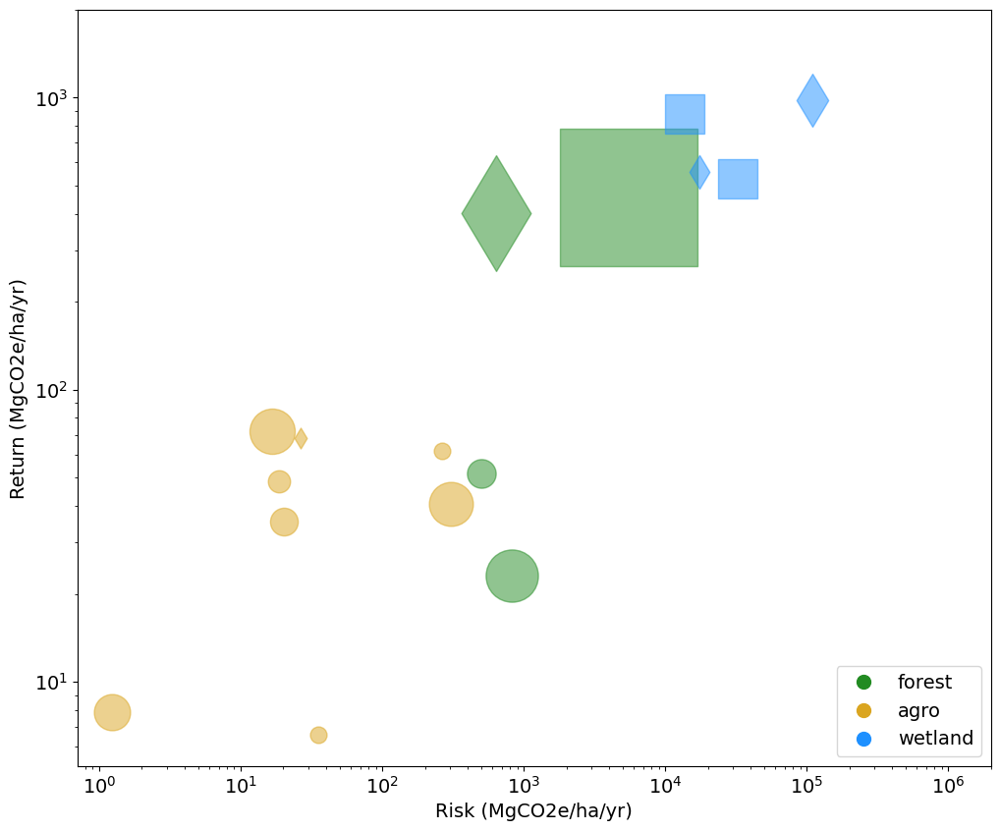

In [5]:
## Create the scatter plot
from matplotlib.lines import Line2D

# Sample data
x = df['Intensity Var']
y = df['Intensity']
color = df['Color']
size = df['Mitigation Potential']
marker_styles = ['d', 's', 'o', 'o', 'o', 'o', 'd', 'o', 'o', 'o', 'o', 'o', 'o', 'o', 'o', 'o', 'd', 'd', 's', 's']

plt.figure(figsize=(12, 10))  # Adjust the figure size as needed

# Loop through data and assign different marker styles
for xi, yi, ci, si, marker in zip(x, y, color, size, marker_styles):
    plt.scatter(xi, yi, c=ci, s=si, marker=marker, alpha=0.5)


plt.xscale('log')
plt.yscale('log')

point1 = Line2D([0], [0], label='forest', marker='o', markersize=10, 
          color='forestgreen', linestyle='')
point2 = Line2D([0], [0], label='agro', marker='o', markersize=10, 
         color='goldenrod', linestyle='')
point3 = Line2D([0], [0], label='wetland', marker='o', markersize=10, 
          color='dodgerblue', linestyle='')

# add manual symbols to auto legend
handles=[point1, point2, point3]

plt.legend(handles=handles,loc='lower right')




# Add labels to each point using DataFrame index
#for label, x, y in zip(df.index[::], df['Intensity Var'], df['Intensity']):
  #  plt.annotate(label, (x, y),textcoords="offset points", xytext=(-15,0),  ha='left', fontsize=10)
# Set plot title and labels
plt.ylim(0,2000)
plt.xlim(-10,2000000)
#plt.title("Scatter Plot")
plt.xlabel("Risk (MgCO2e/ha/yr)")
plt.ylabel("Return (MgCO2e/ha/yr)")

plt.savefig(PATH_SAVE_FIGURES + "Fig1.pdf", bbox_inches = "tight", dpi = 300) 

# Show the plot
plt.show()


### Create random portfolios
Select 2 to 20 assets-portfolio among 20 listed NCS - can repeat asset                         
For Figure 2 only 2 assets and df = df.loc[['Trees in Cropland','Improved Plantation']]
For ternary plot etc, check only one p value and at least portfolios of 10 assets

Do either in terms of TgCO2/yr or MgCO2/ha


In [25]:
## - How many assets to include in each portfolio
n_assets = 10

# Define asset means and variances
#df = df[df['Intensity'].notna()]
#asset_list = df.index

#change into this for figure 2
#df = df.loc[['Trees in Cropland','Improved Plantation']]
asset_list = df.index
means = df[['Mitigation Potential']] # or 'Mitigation Potential' TgCO2e/yr
var = df[['Var']] # or VAR , VAR min has some value equal to 0, not good

#for figure 2
#means = df[['Intensity']] # or 'Mitigation Potential' TgCO2e/yr
#var = df[['Intensity Var']] # or VAR , VAR min has some value equal to 0, not good


#-- How many portfolios to generate
n_portfolios = 10000

#-- Initialize empty list to store mean-variance pairs for plotting
mean_variance_pairs = []
weights_list=[]
np.random.seed(75)

#-- Loop through different values of p (exponentially spaced)
p_values = np.linspace(1., 1., 1)
#p_values = np.linspace(0., 1., 5) #this is for the 2 asset option

cumulative_weights_list = []
cumulative_weights_list2 = []

for p in p_values:
    cov_data = np.zeros((len(df.index), len(df.index)))
    for i,asset1 in enumerate(asset_list):
        for j,asset2 in enumerate(asset_list):
            if asset1 == asset2:
                cov_data[i, j] = var.loc[asset1].values[0]
            else:
                cov_data[i, j] = p * np.sqrt(var.loc[asset1].values[0]) * np.sqrt(var.loc[asset2].values[0])
    cov = pd.DataFrame(cov_data, columns=asset_list, index=asset_list)
    
    #-- Loop through and generate lots of random portfolios
    for i in range(n_portfolios):
        #- Choose assets randomly without replacement
        assets = np.random.choice(asset_list, n_assets, replace=True)
        #- Choose weights randomly
        weights = np.random.rand(n_assets)
        #- Ensure weights sum to 1
        weights = weights/sum(weights)
        
        portfolio_E_Variance = 0
        portfolio_E_Return = 0
        for i, asset in enumerate(assets):
            portfolio_E_Return += weights[i] * means.loc[asset, 'Mitigation Potential']
            for j, asset_ in enumerate(assets):
                #-- Add variance/covariance for each asset pair
                #- Note that when i==j this adds the variance
                portfolio_E_Variance += weights[i] * weights[j] * cov.loc[asset, asset_]
        
        # Calculate cumulative weights by cover type for the current portfolio
        cumulative_weights_by_cover_type = {}
        cover_types = df.loc[assets, "Color"]
        for asset, weight, cover_type in zip(assets, weights, cover_types):
            if cover_type not in cumulative_weights_by_cover_type:
                cumulative_weights_by_cover_type[cover_type] = 0
            cumulative_weights_by_cover_type[cover_type] += weight
        # Append the cumulative weights to the list for all portfolios
        cumulative_weights_list.append(cumulative_weights_by_cover_type)

        # Calculate cumulative weights by intervention type for the current portfolio
        cumulative_weights_by_intervention_type = {}
        intervention_types = df.loc[assets, "Intervention type"]
        for asset, weight, intervention_type in zip(assets, weights, intervention_types):
            if intervention_type not in cumulative_weights_by_intervention_type:
                cumulative_weights_by_intervention_type[intervention_type] = 0
            cumulative_weights_by_intervention_type[intervention_type] += weight
        cumulative_weights_list2.append(cumulative_weights_by_intervention_type)
        # Find the "Intervention type" with the maximum cumulative weight for the current portfolio
        max_intervention_type = max(cumulative_weights_by_intervention_type, key=cumulative_weights_by_intervention_type.get)
        
        # Find the "Cover type" with the maximum cumulative weight for the current portfolio
        max_cover_type = max(cumulative_weights_by_cover_type, key=cumulative_weights_by_cover_type.get)
        #print(assets, weights, max_cover_type)
        #-- Add the mean/variance pairs to a list for plotting
        mean_variance_pairs.append([portfolio_E_Return, portfolio_E_Variance, p])
        weights_list.append([weights,assets, max_cover_type, max_intervention_type])
#-- Convert the list to a DataFrame for further analysis or plotting
mean_variance_df = pd.DataFrame(mean_variance_pairs, columns=['Return', 'Variance', 'p'])
weights_list_df = pd.DataFrame( weights_list, columns=['Weights', 'Assets', 'Max Cover', 'Max Intervention'])
risk_free_rate=0 #-- Include risk free rate here
weights_list_df['Sharpe Ratio'] = (mean_variance_df['Return'] - risk_free_rate) / mean_variance_df['Variance']
# Concatenate the DataFrames horizontally
combined_df = pd.concat([mean_variance_df, weights_list_df], axis=1)
cumulative_weights_df = pd.DataFrame(cumulative_weights_list)
cumulative_weights_df2=pd.DataFrame(cumulative_weights_list2)
cumulative_weights_df = pd.concat([cumulative_weights_df,cumulative_weights_df2], axis=1)

Find Minimum Variance portfolio

In [8]:
# Get the "Weights" and "Assets" corresponding to the minimum Variance value
min_var_weights = combined_df.loc[combined_df['Variance'].idxmin(), 'Weights']
min_var_assets = combined_df.loc[combined_df['Variance'].idxmin(), 'Assets']

# Print the results
print(f"Minimum Variance: {combined_df['Variance'].min()}")
print(f"Weights: {min_var_weights}")
print(f"Assets: {min_var_assets}")

Minimum Variance: 1733.985058647781
Weights: [0.17044088 0.1698804  0.04768823 0.00762837 0.18486752 0.01637405
 0.01528064 0.17375259 0.06364644 0.15044089]
Assets: ['Avoided Woodfuel Harvest' 'Improved Rice Cultivation'
 'Improved Rice Cultivation' 'Grazing - Improved feed'
 'Improved Rice Cultivation' 'Fire Management' 'Avoided Woodfuel Harvest'
 'Avoided Woodfuel Harvest' 'Avoided Grassland Conversion'
 'Coastal Wetland Restoration']


Find the best compromise portfolio

In [9]:
# Get the "Weights" and "Assets" corresponding to the minimum Variance value
max_sharpe_weights = combined_df.loc[combined_df['Sharpe Ratio'].idxmax(), 'Weights']
max_sharpe_assets = combined_df.loc[combined_df['Sharpe Ratio'].idxmax(), 'Assets']

# Print the results
print(f"Maximum Sharpe Ratio Values: {combined_df['Sharpe Ratio'].max()}")
print(f"Weights: {max_sharpe_weights}")
print(f"Assets: {max_sharpe_assets}")

Maximum Sharpe Ratio Values: 0.21980289586443097
Weights: [0.17044088 0.1698804  0.04768823 0.00762837 0.18486752 0.01637405
 0.01528064 0.17375259 0.06364644 0.15044089]
Assets: ['Avoided Woodfuel Harvest' 'Improved Rice Cultivation'
 'Improved Rice Cultivation' 'Grazing - Improved feed'
 'Improved Rice Cultivation' 'Fire Management' 'Avoided Woodfuel Harvest'
 'Avoided Woodfuel Harvest' 'Avoided Grassland Conversion'
 'Coastal Wetland Restoration']


Plot Efficient Frontier

In [26]:
## -- Plot the risk vs. return of randomly generated portfolios
#-- Convert the list from before into an array for easy plotting
mean_variance_pairs = np.array(mean_variance_pairs)

fig = go.Figure()

# Determine the overall minimum and maximum values for color scale
min_color = combined_df['Return'].min() - risk_free_rate
max_color = combined_df['Return'].max() - risk_free_rate

min_variance = combined_df['Variance'].min()
max_variance = combined_df['Variance'].max()

min_color = min_color / max_variance / 100
max_color = max_color / min_variance / 1000

# Define marker symbols for different intervention types
marker_symbols = {
    'manage': 'circle',
    'restore': 'square',
    'protect': 'diamond',
    # Add more symbols for other intervention types as needed
}

# Loop through unique values of p
for p in combined_df['p'].unique():
    
    dff = combined_df[combined_df['p'] == p]

    fig.add_trace(
        go.Scatter(
            x=np.sqrt(dff['Variance']),
            y=dff['Return'],
            marker=dict(
                #symbol=[marker_symbols[type] for type in dff['Max Intervention']],
                color=dff['Max Cover'],
                size=6,
                line=dict(width=1),
                colorscale="PiYG",
                cmin=min_color,
                cmax=max_color,
                showscale=False
            ),
            mode='markers',
            text=[
                f'p = {p}<br>w={", ".join([f"{w:.2f} ({a})" for w, a in zip(weights, assets)])}'
                for weights, assets in zip(dff['Weights'], dff['Assets'])
            ],
            name='',
            showlegend=False
        )
    )

fig.update_layout(
    template='plotly_white',
    xaxis=dict(title='Carbon Loss Risk (tC/ha)'),
    yaxis=dict(title='Carbon Return (tC/ha)'),
    #title='NCS Portfolios',
    width=700,
    height=450,
    coloraxis_colorbar=dict(
        title="Sharpe Ratio", lenmode="fraction", len=0.8,
        yanchor="top", y=0.95, ticks="outside", ticklen=4
    ),
    coloraxis=dict(cmin=min_color, cmax=max_color)
)

  
#fig.update_xaxes(type='log')

#range for figure 2
#fig.update_xaxes(range=[12, 26]) 
#fig.update_yaxes(range=[38,54]) 

#fig.write_image(PATH_SAVE_FIGURES + "Fig1B.pdf") 
fig.show()


## Ternary Plot

Need to have the full df here

In [42]:
import plotly.express as px
import plotly.graph_objects as go
min_color = combined_df['Return'].min() - risk_free_rate
max_color = combined_df['Return'].max() - risk_free_rate

fig = go.Figure(go.Scatterternary({
    'mode': 'markers',
    'a': cumulative_weights_df['dodgerblue'],
    'b': cumulative_weights_df['goldenrod'],
    'c': cumulative_weights_df['forestgreen'],
    
    'marker': {
        'color': dff['Return'],  # Marker color based on Variance
        'colorscale': 'RdBu_r',  # You can change the colorscale if needed
        'size': 5 + 25 * (dff['Variance'] - min_variance) / (max_variance - min_variance),  # Adjust size based on Return,
        'line': {'width': 1},
        'cmin': min_color,  # Set the minimum color value
        'cmax': max_color,  # Set the maximum color value
        'colorbar': dict(
                    title="Return (TgCO2eq/yr)", 
                    x=1.4,  # Set the x-coordinate to 0 (left side)
                    y=1.0,  # Set the y-coordinate to 1.0 (top side)
                    len=0.7,  # Adjust the length as needed
                    yanchor="top", ticks="outside", ticklen=4,
                ),
    }
}
))

# Update axis labels and layout
fig.update_layout({
    'ternary': {
        'sum': 1,
        'aaxis_title': 'Wetland',
        'baxis_title': 'Agriculture',
        'caxis_title': 'Forest',
       },
})

#fig.write_image(PATH_SAVE_FIGURES + "Fig3A.pdf") 

# Show the plot
fig.show()

#### Manage - Restore - Protect

In [31]:
fig = go.Figure(go.Scatterternary({
    'mode': 'markers',
    'a': cumulative_weights_df['protect'],
    'b': cumulative_weights_df['manage'],
    'c': cumulative_weights_df['restore'],
    
    'marker': {
        'color': dff['Return'],  # Marker color based on Variance
        'colorscale': 'RdBu_r',  # You can change the colorscale if needed
        'size': 5 + 25 * (dff['Variance'] - min_variance) / (max_variance - min_variance),  # Adjust size based on Return,
        'line': {'width': 1},
        'cmin': min_color,  # Set the minimum color value
        'cmax': max_color,  # Set the maximum color value
        #'colorbar': dict(
        #            title="Mean (TgCO2eq/yr)", 
        #            x=0.2,  # Set the x-coordinate to 0 (left side)
        #            y=1.0,  # Set the y-coordinate to 1.0 (top side)
        #            len=0.5,  # Adjust the length as needed
        #            yanchor="top", ticks="outside", ticklen=4,
         #       ),
    }
}
))

# Update axis labels and layout
fig.update_layout({
    'ternary': {
        'sum': 1,
        'aaxis_title': 'Protect',
        'baxis_title': 'Manage',
        'caxis_title': 'Restore',
       },
})

fig.write_image(PATH_SAVE_FIGURES + "Fig3B.pdf") 

# Show the plot
fig.show()


### Cost-effective NCS only portfolio

Variance is adjusted considering the proportion of the target that is cost effective

In [14]:
df[['Low Cost Potential']]

,Low Cost Potential
Pathway (Griscom 2017),
Avoided Forest Conversion,1816.0
Reforestation,0.0
Natural Forest Management,441.0
Improved Plantation,0.0
Fire Management,0.0
Avoided Woodfuel Harvest,0.0
Avoided Grassland Conversion,0.0
Biochar,0.0
Cropland Nutrient Management,635.0


In [15]:
# Filter asset list based on "Cover type" or "Intervention type" column
asset_list = df[df['Low Cost Potential'] != 0.0].index

#- How many assets to include in each portfolio
n_assets = len(asset_list)
# Define asset means and variances
means = df[['Low Cost Potential']]
var = df[['Low Cost Var']]

#-- How many portfolios to generate
n_portfolios = 10000

#-- Initialize empty list to store mean-variance pairs for plotting
mean_variance_pairs = []
weights_list=[]
np.random.seed(75)

#-- Loop through different values of p (exponentially spaced)
p_values = np.linspace(0., 1., 1)

cumulative_weights_list=[]
cumulative_weights_list2=[]

for p in p_values:
    cov_data = np.zeros((len(asset_list), len(asset_list)))
    for i,asset1 in enumerate(asset_list):
        for j,asset2 in enumerate(asset_list):
            if asset1 == asset2:
                cov_data[i, j] = var.loc[asset1].values[0]
            else:
                cov_data[i, j] = p * np.sqrt(var.loc[asset1].values[0]) * np.sqrt(var.loc[asset2].values[0])
    cov = pd.DataFrame(cov_data, columns=asset_list, index=asset_list)
    
    #-- Loop through and generate lots of random portfolios
    for i in range(n_portfolios):
        #- Choose assets randomly without replacement
        assets = np.random.choice(asset_list, n_assets, replace=False)
        #- Choose weights randomly
        weights = np.random.rand(n_assets)
        #- Ensure weights sum to 1
        weights = weights/sum(weights)
        
        portfolio_E_Variance = 0
        portfolio_E_Return = 0
        for i, asset in enumerate(assets):
            portfolio_E_Return += weights[i] * means.loc[asset, 'Low Cost Potential']
            for j, asset_ in enumerate(assets):
                #-- Add variance/covariance for each asset pair
                #- Note that when i==j this adds the variance
                portfolio_E_Variance += weights[i] * weights[j] * cov.loc[asset, asset_]
        
        # Calculate cumulative weights by cover type for the current portfolio
        cumulative_weights_by_cover_type = {}
        cover_types = df.loc[assets, "Color"]
        for asset, weight, cover_type in zip(assets, weights, cover_types):
            if cover_type not in cumulative_weights_by_cover_type:
                cumulative_weights_by_cover_type[cover_type] = 0
            cumulative_weights_by_cover_type[cover_type] += weight
        cumulative_weights_list.append(cumulative_weights_by_cover_type)
        # Calculate cumulative weights by intervention type for the current portfolio
        cumulative_weights_by_intervention_type = {}
        intervention_types = df.loc[assets, "Intervention type"]
        for asset, weight, intervention_type in zip(assets, weights, intervention_types):
            if intervention_type not in cumulative_weights_by_intervention_type:
                cumulative_weights_by_intervention_type[intervention_type] = 0
            cumulative_weights_by_intervention_type[intervention_type] += weight
        cumulative_weights_list2.append(cumulative_weights_by_intervention_type)
        # Find the "Intervention type" with the maximum cumulative weight for the current portfolio
        max_intervention_type = max(cumulative_weights_by_intervention_type, key=cumulative_weights_by_intervention_type.get)
        
        # Find the "Cover type" with the maximum cumulative weight for the current portfolio
        max_cover_type = max(cumulative_weights_by_cover_type, key=cumulative_weights_by_cover_type.get)
        #print(assets, weights, max_cover_type)
        #-- Add the mean/variance pairs to a list for plotting
        mean_variance_pairs.append([portfolio_E_Return, portfolio_E_Variance, p])
        weights_list.append([weights,assets, max_cover_type, max_intervention_type])
#-- Convert the list to a DataFrame for further analysis or plotting
mean_variance_df = pd.DataFrame(mean_variance_pairs, columns=['Return', 'Variance', 'p'])
weights_list_df = pd.DataFrame( weights_list, columns=['Weights', 'Assets', 'Max Cover', 'Max Intervention'])
risk_free_rate=0 #-- Include risk free rate here
weights_list_df['Sharpe Ratio'] = (mean_variance_df['Return'] - risk_free_rate) / mean_variance_df['Variance']
# Concatenate the DataFrames horizontally
combined_df = pd.concat([mean_variance_df, weights_list_df], axis=1)
cumulative_weights_df = pd.DataFrame(cumulative_weights_list)
cumulative_weights_df2= pd.DataFrame(cumulative_weights_list2)
cumulative_weights_df = pd.concat([cumulative_weights_df,cumulative_weights_df2], axis=1)

In [16]:
## -- Plot the risk vs. return of randomly generated portfolios
#-- Convert the list from before into an array for easy plotting
mean_variance_pairs = np.array(mean_variance_pairs)

fig = go.Figure()

# Determine the overall minimum and maximum values for color scale
min_colorL = combined_df['Return'].min() - risk_free_rate
max_colorL = combined_df['Return'].max() - risk_free_rate

min_varianceL = combined_df['Variance'].min()
max_varianceL = combined_df['Variance'].max()

min_colorL = min_colorL / max_varianceL / 100
max_colorL = max_colorL / min_varianceL / 1000

# Define marker symbols for different intervention types
marker_symbols = {
    'manage': 'circle',
    'restore': 'square',
    'protect': 'diamond',
    # Add more symbols for other intervention types as needed
}

# Loop through unique values of p
for p in combined_df['p'].unique():
    dff = combined_df[combined_df['p'] == p]

    fig.add_trace(
        go.Scatter(
            x=dff['Variance'],
            y=dff['Return'],
            marker=dict(
                symbol=[marker_symbols[type] for type in dff['Max Intervention']],
                color=dff['Max Cover'],
                size=[14 if i == dff['Variance'].idxmin() else 7 for i in range(len(dff))],
                line=dict(width=1),
                colorscale="PiYG",
                cmin=min_colorL,
                cmax=max_colorL,
                showscale=False
            ),
            mode='markers',
            text=[
                f'p = {p}<br>w={", ".join([f"{w:.2f} ({a})" for w, a in zip(weights, assets)])}'
                for weights, assets in zip(dff['Weights'], dff['Assets'])
            ],
            name='',
            showlegend=False
        )
    )

fig.update_layout(
    template='plotly_white',
    xaxis=dict(title='Carbon Loss Risk (tC/ha)'),
    yaxis=dict(title='Carbon Return (tC/ha)'),
   # title='NCS Portfolios',
    width=650,
    height=400,
    coloraxis_colorbar=dict(
        title="Sharpe Ratio", lenmode="fraction", len=0.8,
        yanchor="top", y=0.95, ticks="outside", ticklen=4
    ),
    coloraxis=dict(cmin=min_color, cmax=max_color)
)

#fig.update_xaxes(type='log')
#fig.write_image(PATH_SAVE_FIGURES + "Fig5.pdf") 

fig.show()

### Ternary plot - cost effective 

Forest - Agro - Wetland

In [23]:
fig = go.Figure(go.Scatterternary({
    'mode': 'markers',
    'a': cumulative_weights_df['dodgerblue'],
    'b': cumulative_weights_df['goldenrod'],
    'c': cumulative_weights_df['forestgreen'],
    
    'marker': {
        'color': dff['Return'],  # Marker color based on Variance
        'colorscale': 'RdBu_r',  # You can change the colorscale if needed
        'size': 5 + 20 * (dff['Variance'] - min_variance) / (max_variance - min_variance),  # Adjust size based on Return,
        'line': {'width': 1},
        'cmin': min_color,  # Set the minimum color value
        'cmax': max_color,  # Set the maximum color value
        
    }
}
))

# Update axis labels and layout
fig.update_layout({
    'ternary': {
        'sum': 1,
        'aaxis_title': 'Wetland',
        'baxis_title': 'Agriculture',
        'caxis_title': 'Forest',
       },
})

fig.write_image(PATH_SAVE_FIGURES + "Fig3C.pdf") 

# Show the plot
fig.show()

In [24]:
fig = go.Figure(go.Scatterternary({
    'mode': 'markers',
    'a': cumulative_weights_df['protect'],
    'b': cumulative_weights_df['manage'],
    'c': cumulative_weights_df['restore'],
    
    'marker': {
        'color': dff['Return'],  # Marker color based on Variance
        'colorscale': 'RdBu_r',  # You can change the colorscale if needed
        'size': 5 + 25 * (dff['Variance'] - min_variance) / (max_variance - min_variance),  # Adjust size based on Return,
        'line': {'width': 1},
        'cmin': min_color,  # Set the minimum color value
        'cmax': max_color,  # Set the maximum color value
        #'colorbar': dict(
        #            title="Mean (TgCO2eq/yr)", 
        #            x=0.2,  # Set the x-coordinate to 0 (left side)
        #            y=1.0,  # Set the y-coordinate to 1.0 (top side)
        #            len=0.5,  # Adjust the length as needed
        #            yanchor="top", ticks="outside", ticklen=4,
        #        ),
    }
}
))

# Update axis labels and layout
fig.update_layout({
    'ternary': {
        'sum': 1,
        'aaxis_title': 'Protect',
        'baxis_title': 'Manage',
        'caxis_title': 'Restore',
       },
})

fig.write_image(PATH_SAVE_FIGURES + "Fig3D.pdf") 

# Show the plot
fig.show()


#### Spatial correlation

In [ ]:

# Define the area range from 0 ha to 10000 ha
area = np.linspace(0, 10000, 100)

# Define the inverse power-law function for correlation
power = 4  # Adjust the power value to control the rate of decrease
p = 1 / (1 + (area*2 / 5000) ** power)

# Create a scatter plot of correlation vs. area
fig = go.Figure(data=go.Scatter(x=area, y=p, mode='lines', line=dict(color='green')))
fig.update_layout(
    title='Correlation Decay with Area',
    xaxis_title='Area (ha)',
    yaxis_title='Correlation (p)',
    showlegend=False,
    template='plotly_white'
)
fig.show()

### Portfolio based on Intervention or Cover type

In [ ]:
# Filter asset list based on "Cover type" or "Intervention type" column
asset_list = df[df['Intervention type'] == 'restore'].index

#- How many assets to include in each portfolio
n_assets = len(asset_list)

# Define asset means and variances
means = df[['Mitigation Potential']]
var = df[['Var']]

#-- How many portfolios to generate
n_portfolios = 1000

#-- Initialize empty list to store mean-variance pairs for plotting
mean_variance_pairs = []
weights_list=[]
np.random.seed(75)

#-- Loop through different values of p (exponentially spaced)
p_values = np.linspace(0., 1., 1)

for p in p_values:
    cov_data = np.zeros((len(asset_list), len(asset_list)))
    for i,asset1 in enumerate(asset_list):
        for j,asset2 in enumerate(asset_list):
            if asset1 == asset2:
                cov_data[i, j] = var.loc[asset1].values[0]
            else:
                cov_data[i, j] = p * np.sqrt(var.loc[asset1].values[0]) * np.sqrt(var.loc[asset2].values[0])
    cov = pd.DataFrame(cov_data, columns=asset_list, index=asset_list)
    
    #-- Loop through and generate lots of random portfolios
    for i in range(n_portfolios):
        #- Choose assets randomly without replacement
        assets = np.random.choice(asset_list, n_assets, replace=True)
        #- Choose weights randomly
        weights = np.random.rand(n_assets)
        #- Ensure weights sum to 1
        weights = weights/sum(weights)
        
        portfolio_E_Variance = 0
        portfolio_E_Return = 0
        for i, asset in enumerate(assets):
            portfolio_E_Return += weights[i] * means.loc[asset, 'Mitigation Potential']
            for j, asset_ in enumerate(assets):
                #-- Add variance/covariance for each asset pair
                #- Note that when i==j this adds the variance
                portfolio_E_Variance += weights[i] * weights[j] * cov.loc[asset, asset_]
        
        # Calculate cumulative weights by cover type for the current portfolio
        cumulative_weights_by_cover_type = {}
        cover_types = df.loc[assets, "Color"]
        for asset, weight, cover_type in zip(assets, weights, cover_types):
            if cover_type not in cumulative_weights_by_cover_type:
                cumulative_weights_by_cover_type[cover_type] = 0
            cumulative_weights_by_cover_type[cover_type] += weight
        
        # Calculate cumulative weights by intervention type for the current portfolio
        cumulative_weights_by_intervention_type = {}
        intervention_types = df.loc[assets, "Intervention type"]
        for asset, weight, intervention_type in zip(assets, weights, intervention_types):
            if intervention_type not in cumulative_weights_by_intervention_type:
                cumulative_weights_by_intervention_type[intervention_type] = 0
            cumulative_weights_by_intervention_type[intervention_type] += weight
        
        # Find the "Intervention type" with the maximum cumulative weight for the current portfolio
        max_intervention_type = max(cumulative_weights_by_intervention_type, key=cumulative_weights_by_intervention_type.get)
        
        # Find the "Cover type" with the maximum cumulative weight for the current portfolio
        max_cover_type = max(cumulative_weights_by_cover_type, key=cumulative_weights_by_cover_type.get)
        #print(assets, weights, max_cover_type)
        #-- Add the mean/variance pairs to a list for plotting
        mean_variance_pairs.append([portfolio_E_Return, portfolio_E_Variance, p])
        weights_list.append([weights,assets, max_cover_type, max_intervention_type])
#-- Convert the list to a DataFrame for further analysis or plotting
mean_variance_df = pd.DataFrame(mean_variance_pairs, columns=['Return', 'Variance', 'p'])
weights_list_df = pd.DataFrame( weights_list, columns=['Weights', 'Assets', 'Max Cover', 'Max Intervention'])
risk_free_rate=0 #-- Include risk free rate here
weights_list_df['Sharpe Ratio'] = (mean_variance_df['Return'] - risk_free_rate) / mean_variance_df['Variance']
# Concatenate the DataFrames horizontally
combined_df = pd.concat([mean_variance_df, weights_list_df], axis=1)

In [ ]:
dfasset_list = df[df['Intervention type'] == 'restore'].index
print(len(asset_list))

Plot efficient frontier for category-portfolio

In [ ]:
## -- Plot the risk vs. return of randomly generated portfolios
#-- Convert the list from before into an array for easy plotting
mean_variance_pairs = np.array(mean_variance_pairs)

fig = go.Figure()

# Determine the overall minimum and maximum values for color scale
min_color = combined_df['Return'].min() - risk_free_rate
max_color = combined_df['Return'].max() - risk_free_rate

min_variance = combined_df['Variance'].min()
max_variance = combined_df['Variance'].max()

min_color = min_color / max_variance / 100
max_color = max_color / min_variance / 1000

# Define marker symbols for different intervention types
marker_symbols = {
    'manage': 'circle',
    'restore': 'square',
    'protect': 'diamond',
    # Add more symbols for other intervention types as needed
}

# Loop through unique values of p
for p in combined_df['p'].unique():
    dff = combined_df[combined_df['p'] == p]

    fig.add_trace(
        go.Scatter(
            x=dff['Variance'],
            y=dff['Return'],
            marker=dict(
                symbol=[marker_symbols[type] for type in dff['Max Intervention']],
                color=dff['Max Cover'],
                size=[14 if i == dff['Sharpe Ratio'].idxmax() else 7 for i in range(len(dff))],
                line=dict(width=1),
                colorscale="PiYG",
                cmin=min_color,
                cmax=max_color,
                showscale=False
            ),
            mode='markers',
            text=[
                f'p = {p}<br>w={", ".join([f"{w:.2f} ({a})" for w, a in zip(weights, assets)])}'
                for weights, assets in zip(dff['Weights'], dff['Assets'])
            ],
            name='',
            showlegend=False
        )
    )
    
#fig.update_xaxes(range=[0, 3000])
#fig.update_yaxes(range=[0, 30000])

fig.update_layout(
    template='plotly_white',
    xaxis=dict(title='Carbon Loss Risk (tC/ha)'),
    yaxis=dict(title='Carbon Return (tC/ha)'),
    #title='NCS Portfolios',
    width=450,
    height=500,
    coloraxis_colorbar=dict(
        title="Sharpe Ratio", lenmode="fraction", len=0.8,
        yanchor="top", y=0.95, ticks="outside", ticklen=4
    ),
    coloraxis=dict(cmin=min_color, cmax=max_color)
)

#fig.update_xaxes(type='log')
fig.write_image(PATH_SAVE_FIGURES + "Fig4c.pdf") 

fig.show()

## Forest portfolios with spatial correlations

In [23]:
df_for = pd.read_excel("NaturalClimateSolution Portfolio.xlsx", sheet_name='Forest', header=3)
df_for = df_for.iloc[:4, 3:]
df_for = df_for.set_index('Pathway')
df_for

,Region,Rate of avoidable impact,Unnamed: 6,Max extension,Extent Low Bound,Extent High bound,Avoidable flux,Additional sequestration,Flux Low bound,Flux High Bound,std,var,Years until saturation,Max potenital,tot return,tot risk
Pathway,,,,,,,,,,,,,,,,
Reforestation (temp),Temperate,NaN,NaN,206,70.04,341.96,NaN,2.82,1.9176,3.7224,0.460408,0.211976,NaN,NaN,10349400.0,320831.4
Reforestation (trop),Tropical,NaN,NaN,472,160.48,783.52,NaN,4.71,3.2028,6.2172,0.768980,0.591330,NaN,NaN,17285700.0,1054427.7
Reforestation t,Temperate,NaN,NaN,NaN,NaN,NaN,NaN,2.82,1.9176,3.7224,0.460408,0.211976,NaN,NaN,10349400.0,320831.4
Reforestation,Tropical,NaN,NaN,NaN,NaN,NaN,NaN,4.71,3.2028,6.2172,0.768980,0.591330,NaN,NaN,17285700.0,1054427.7


Create portfolios of 2 assets (can be repeated) with all range of p: for assets belongin to differnet region p is automatically 0

Now changed to tot risk and tot return based on a million ha of reforestation, ad the percetages of loss coming from disturbances (fires, severe weather, disease and insects, FAO data
)

In [24]:
## - How many assets to include in each portfolio
n_assets = 2

# Define asset means and variances
asset_list = df_for.index
means = df_for[['tot return']]   #originally Additional sequestration
var = df_for[['tot risk']] # VAR min has some value equal to 0, not good - originally var

#-- How many portfolios to generate
n_portfolios = 1000

#-- Initialize empty list to store mean-variance pairs for plotting
mean_variance_pairs = []
weights_list=[]
np.random.seed(75)

#-- Loop through different values of p (exponentially spaced)
p_values = np.linspace(0., 1., 5)

for p in p_values:
    cov_data = np.zeros((len(df_for.index), len(df_for.index)))
    for i,asset1 in enumerate(asset_list):
        for j,asset2 in enumerate(asset_list):
            if asset1 == asset2:
                cov_data[i, j] = var.loc[asset1].values[0]
            #if one is temperate one is tropical they are automatically uncorrelated    
            else:
                if df_for.loc[asset1, 'Region'] != df_for.loc[asset2, 'Region']: 
                    cov_data[i, j] = 0
                else:
                    cov_data[i, j] = p * np.sqrt(var.loc[asset1].values[0]) * np.sqrt(var.loc[asset2].values[0])
    cov = pd.DataFrame(cov_data, columns=asset_list, index=asset_list)

    #-- Loop through and generate lots of random portfolios
    for i in range(n_portfolios):
        #- Choose assets randomly, one asset can be picked multple times
        assets = np.random.choice(asset_list, n_assets, replace=True)
        #- Choose weights randomly
        weights = np.random.rand(n_assets)
        #- Ensure weights sum to 1
        weights = weights/sum(weights)
        
        portfolio_E_Variance = 0
        portfolio_E_Return = 0
        for i, asset in enumerate(assets):
            portfolio_E_Return += weights[i] * means.loc[asset, 'tot return']
            for j, asset_ in enumerate(assets):
                #-- Add variance/covariance for each asset pair
                #- Note that when i==j this adds the variance
                portfolio_E_Variance += weights[i] * weights[j] * cov.loc[asset, asset_]
                
       
        #-- Add the mean/variance pairs to a list for plotting
        mean_variance_pairs.append([portfolio_E_Return, portfolio_E_Variance, p])
        weights_list.append([weights,assets])
#-- Convert the list to a DataFrame for further analysis or plotting
mean_variance_df = pd.DataFrame(mean_variance_pairs, columns=['Return', 'Variance', 'p'])
weights_list_df = pd.DataFrame( weights_list, columns=['Weights', 'Assets'])
risk_free_rate=0 #-- Include risk free rate here
weights_list_df['Sharpe Ratio'] = (mean_variance_df['Return'] - risk_free_rate) / mean_variance_df['Variance']

# Concatenate the DataFrames horizontally
combined_df = pd.concat([mean_variance_df, weights_list_df], axis=1)

Find the max Sharpe Ratio Forest portfolio: pay attention that you need to exclude the total temeprate one that has minimum variance

In [25]:
filtered_df = combined_df[(combined_df['Return'] > 3)]

# Finding the row with the highest Sharpe Ratio in the filtered DataFrame
max_sharpe_row = filtered_df.loc[filtered_df['Sharpe Ratio'].idxmax()]

# Extracting the weights from the row with the highest Sharpe Ratio
max_sharpe_weights = max_sharpe_row['Weights']
max_sharpe_assets =max_sharpe_row['Assets']
print(f"Maximum Sharpe Ratio Values: {combined_df.loc[combined_df['Return'] > 3, 'Sharpe Ratio'].max()}")
print(f"Weights: {max_sharpe_weights}")
print(f"Assets: {max_sharpe_assets}")

Maximum Sharpe Ratio Values: 64.51543348145017
Weights: [0.50164173 0.49835827]
Assets: ['Reforestation t' 'Reforestation (temp)']


Plot mean - var space

In [26]:
## -- Plot the risk vs. return of randomly generated portfolios
#-- Convert the list from before into an array for easy plotting
mean_variance_pairs = np.array(mean_variance_pairs)

fig = go.Figure()

# Determine the overall minimum and maximum values for color scale
min_color = combined_df['Sharpe Ratio'].min()
max_color = combined_df['Sharpe Ratio'].max()
print(min_color, max_color)
min_variance = combined_df['Variance'].min()
max_variance = combined_df['Variance'].max()

#min_color = min_color / max_variance / 100
#max_color = max_color / min_variance / 1000

# Define marker symbols for different intervention types
marker_symbols = {
    'manage': 'circle',
    'restore': 'square',
    'protect': 'diamond',
    # Add more symbols for other intervention types as needed
}

# Loop through unique values of p
for p in combined_df['p'].unique():
    dff = combined_df[combined_df['p'] == p]

    fig.add_trace(
        go.Scatter(
            x=dff['Variance'],
            y=dff['Return'],
            marker=dict(
            color=dff['Sharpe Ratio'],
                size=8,
                line=dict(width=1),
                colorscale="RdBu",
                cmin=min_color,
                cmax=max_color,
                showscale=True,
                colorbar=dict(
                    title="Sharpe Ratio", 
                    x=0.1,  # Set the x-coordinate to 0 (left side)
                    y=1.0,  # Set the y-coordinate to 1.0 (top side)
                    len=0.3,  # Adjust the length as needed
                    yanchor="top", ticks="outside", ticklen=4,
                ),
            ),
            mode='markers',
            text=[
                f'p = {p}<br>w={", ".join([f"{w:.2f} ({a})" for w, a in zip(weights, assets)])}'
                for weights, assets in zip(dff['Weights'], dff['Assets'])
            ],
            name='',
            showlegend=False
        )
    )

fig.update_layout(
    template='plotly_white',
    xaxis=dict(title='Carbon Risk (MgCO2/yr)'),   #TgC/ha/yr originanlly
    yaxis=dict(title='Carbon Return (MgCO2/yr)'),
    #title='NCS Portfolios',
    width=650,
    height=500,
)

#fig.update_xaxes(type='log')
#fig.update_xaxes(range=[0, 0.6])  
#fig.update_yaxes(range=[2.5, 5]) 
fig.write_image(PATH_SAVE_FIGURES + "FigForest_with_constraint.png") 
fig.show()

16.39344262295081 64.51543348145017


## Wetlands portfolios with spatial correlations¶


In [27]:
df_wet = pd.read_excel("NaturalClimateSolution Portfolio.xlsx", sheet_name='Wetland', header=2)
df_wet = df_wet.set_index('Cover')
df_wet = df_wet.iloc[3:6, 3:]
df_wet

,Pathway,Rate avoidable impact,max extent,Extent Low Bound,Extent High bound,Avoidable flux,Additional Sequestration,Tot sequestration,Flux low bound,Flux High bound,stv,var,Years until saturation,Max additional potential,tot return,tot risk
Cover,,,,,,,,,,,,,,,,
Mangrove,Coastland Wetland Restoration,NaN,11,9,13,8.8,6.4,15.20,12.00,18.40,1.632653,2.665556,100.0,613.624,55784000.0,1249561.60
Salt Marsh,Coastland Wetland Restoration,NaN,2,0.2,3.2,3.57,2.2,5.77,3.43,8.07,1.193878,1.425344,57.0,42.3518,21175900.0,1897360.64
Seagrass,Coastland Wetland Restoration,NaN,17,8.3,25.4,2,1.4,3.40,1.87,4.89,0.780612,0.609355,51.0,212.126,12478000.0,5989440.00


Create portfolio for selected wetland pathways (can be only one but differentiate the type of cover)

In [34]:
## - How many assets to include in each portfolio
n_assets = 3

# Define asset means and variances
asset_list = df_wet.index
means = df_wet[['tot return']] #originally Tot sequestration
var = df_wet[['tot risk']] # VAR min has some value equal to 0, not good

#-- How many portfolios to generate
n_portfolios = 10000

#-- Initialize empty list to store mean-variance pairs for plotting
mean_variance_pairs = []
weights_list=[]
np.random.seed(75)

#-- Loop through different values of p (exponentially spaced)
p_values = np.linspace(0., 1., 2)

for p in p_values:
    cov_data = np.zeros((len(df_wet.index), len(df_wet.index)))
    for i,asset1 in enumerate(asset_list):
        for j,asset2 in enumerate(asset_list):
            if asset1 == asset2:
                cov_data[i, j] = var.loc[asset1].values[0]
            #if one is temperate one is tropical they are automatically uncorrelated    
            else:
                #if df_for.loc[asset1, 'Region'] != df_for.loc[asset2, 'Region']: 
                #    cov_data[i, j] = 0
                #else:
                cov_data[i, j] = p * np.sqrt(var.loc[asset1].values[0]) * np.sqrt(var.loc[asset2].values[0])
    cov = pd.DataFrame(cov_data, columns=asset_list, index=asset_list)
    
    #-- Loop through and generate lots of random portfolios
    for i in range(n_portfolios):
        #- Choose assets randomly, one asset can be picked multple times
        assets = np.random.choice(asset_list, n_assets, replace=True)
        #- Choose weights randomly
        weights = np.random.rand(n_assets)
        #- Ensure weights sum to 1
        weights = weights/sum(weights)
        
        portfolio_E_Variance = 0
        portfolio_E_Return = 0
        for i, asset in enumerate(assets):
            portfolio_E_Return += weights[i] * means.loc[asset, 'tot return']
            for j, asset_ in enumerate(assets):
                #-- Add variance/covariance for each asset pair
                #- Note that when i==j this adds the variance
                portfolio_E_Variance += weights[i] * weights[j] * cov.loc[asset, asset_]
                
       
        #-- Add the mean/variance pairs to a list for plotting
        mean_variance_pairs.append([portfolio_E_Return, portfolio_E_Variance, p])
        weights_list.append([weights,assets])
#-- Convert the list to a DataFrame for further analysis or plotting
mean_variance_df = pd.DataFrame(mean_variance_pairs, columns=['Return', 'Variance', 'p'])
weights_list_df = pd.DataFrame( weights_list, columns=['Weights', 'Assets'])
risk_free_rate=0 #-- Include risk free rate here
weights_list_df['Sharpe Ratio'] = (mean_variance_df['Return'] - risk_free_rate) / mean_variance_df['Variance']

# Concatenate the DataFrames horizontally
combined_df = pd.concat([mean_variance_df, weights_list_df], axis=1)

In [35]:
## -- Plot the risk vs. return of randomly generated portfolios
#-- Convert the list from before into an array for easy plotting
mean_variance_pairs = np.array(mean_variance_pairs)

fig = go.Figure()

# Determine the overall minimum and maximum values for color scale
min_color = combined_df['Return'].min() - risk_free_rate
max_color = combined_df['Return'].max() - risk_free_rate

min_variance = combined_df['Variance'].min()
max_variance = combined_df['Variance'].max()

#min_color = min_color / max_variance / 100
#max_color = max_color / min_variance / 1000
min_color = combined_df['Sharpe Ratio'].min()
max_color = combined_df['Sharpe Ratio'].max()
# Loop through unique values of p
for p in combined_df['p'].unique():
    dff = combined_df[combined_df['p'] == p]

    fig.add_trace(
        go.Scatter(
            x=dff['Variance'],
            y=dff['Return'],
            marker=dict(
        
                color=dff['Sharpe Ratio'],
                size=4,
                line=dict(width=1),
                colorscale="GnBu",
                cmin=min_color,
                cmax=max_color,
                showscale=True,
                colorbar=dict(
                    title="Sharpe Ratio", 
                    x=0.8,  # Set the x-coordinate to 0 (left side)
                    y=1.0,  # Set the y-coordinate to 1.0 (top side)
                    len=0.3,  # Adjust the length as needed
                    yanchor="top", ticks="outside", ticklen=4,
                ),
            ),
            mode='markers',
            text=[
                f'p = {p}<br>w={", ".join([f"{w:.2f} ({a})" for w, a in zip(weights, assets)])}'
                for weights, assets in zip(dff['Weights'], dff['Assets'])
            ],
            name='',
            showlegend=False
        )
    )

fig.update_layout(
    template='plotly_white',
    xaxis=dict(title='Carbon Risk (MgCO2/yr)'),
    yaxis=dict(title='Carbon Return (MgCO2/yr)'),
    #title='NCS Portfolios',
    width=850,
    height=550,
)

#fig.update_xaxes(type='log')
#fig.update_xaxes(range=[0, 0.6])  
#fig.update_yaxes(range=[0, 16]) 
fig.write_image(PATH_SAVE_FIGURES + "FigWetland.png") 
fig.show()

### Correlation Function

In [ ]:
def rho(d, alpha, epsilon):
    if d < epsilon:
        rho = np.exp(-alpha * d / epsilon)
    else:
        rho = (epsilon/(np.e *d))**alpha
    return rho

#values from Zorzetto 2018 Table 2

# Parameters
alpha1 = 0.13
epsilon1 = 13.75

# Define the range of d values
d_values = np.linspace(0, 400.0, 400)  # Adjust the range as needed

# Calculate the corresponding rho values using the defined function
rho_values1 = [rho(d, alpha1, epsilon1) for d in d_values]

# Parameters
alpha2 = 0.28
epsilon2 = 53.14

# Calculate the corresponding rho values for the second set of parameters
rho_values2 = [rho(d, alpha2, epsilon2) for d in d_values]

# Parameters
alpha3 = 0.23
epsilon3 = 26.50

rho_values3 = [rho(d, alpha3, epsilon3) for d in d_values]


# Create a plot
plt.figure(figsize=(3, 2))
plt.plot(d_values, rho_values1, label=f'alpha={alpha1}, epsilon={epsilon1}', color='grey')
#plt.plot(d_values, rho_values2, label=f'alpha={alpha2}, epsilon={epsilon2}', color='green')
#plt.plot(d_values, rho_values3, label=f'alpha={alpha3}, epsilon={epsilon3}', color='orange')

plt.xlabel("d (km)")
plt.ylabel(r"$\rho$ (d)")
#plt.legend()

# Display the plot
plt.savefig(PATH_SAVE_FIGURES + "Fig1binset.pdf", bbox_inches = "tight")
plt.show()

### Risk Aversion

In [41]:
def U(a,x):
    if a==0:
        U=x
    else:
        U= (1 - np.exp(- a*x))/a
    return U

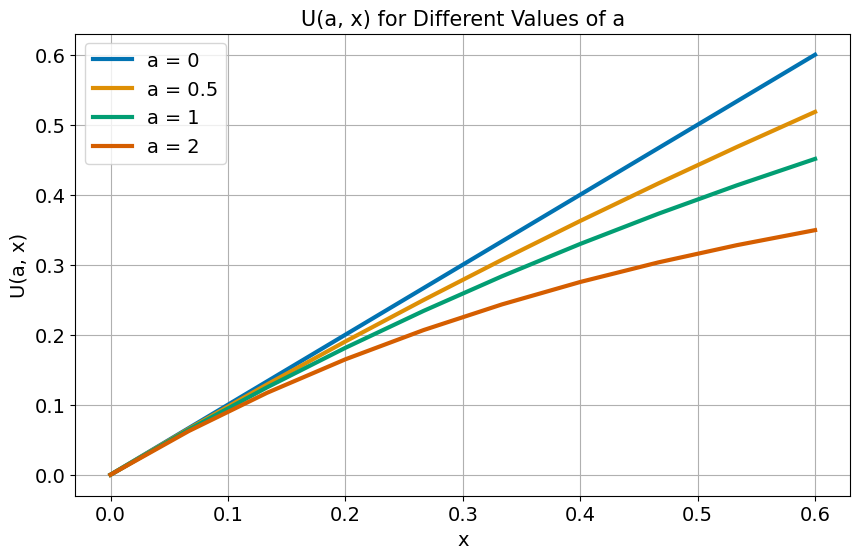

In [58]:
import numpy as np
import matplotlib.pyplot as plt

# Define the U(a, x) function
def U(a, x):
    if a == 0:
        U = x
    else:
        U = (1 - np.exp(-a * x)) / a
    return U

# Values of x (you can adjust the range and resolution)
x = np.linspace(0, .6, 10)

# Values of a to plot
a_values = [0, 0.5, 1, 2]

# Create subplots for each value of a
plt.figure(figsize=(10, 6))

for a in a_values:
    U_values = U(a, x)
    label = f'a = {a}' if a != 0 else 'a = 0'
    plt.plot(x, U_values, label=label)

plt.xlabel('x')
plt.ylabel('U(a, x)')
plt.title('U(a, x) for Different Values of a')
plt.legend()
plt.grid(True)
plt.show()

#### Contour plot

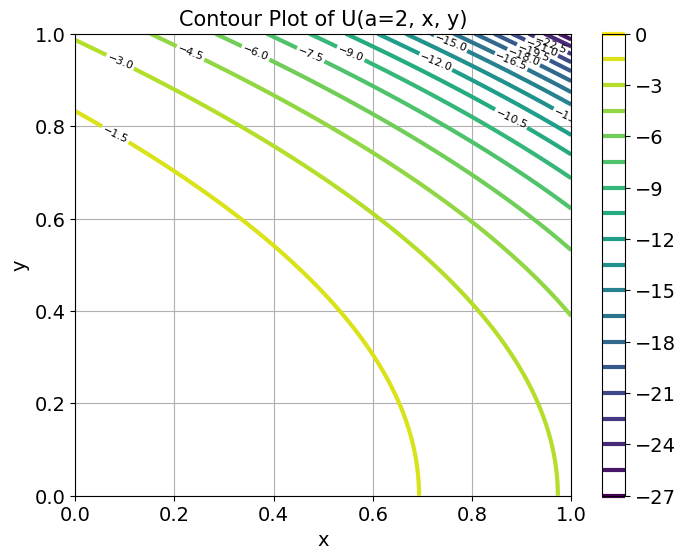

In [59]:
# Define the U(a, x) function
def U(a, x, y):
    'y return, x risk'
    if a==0:
        EU=x
    else:
        EU=(1 - np.exp(a*y + (a**2 * x**2)/2))/a
    return EU

# Define the range of x and y values
x = np.linspace(0, 1, 100)
y = np.linspace(0, 1, 100)

# Create a grid of x and y values
X, Y = np.meshgrid(x, y)

# Choose a fixed value of 'a'
fixed_a = 2

# Compute the values of U(a, x, y) for the fixed 'a'
Z = U(fixed_a, X, Y)

# Create a contour plot
plt.figure(figsize=(8, 6))
contours = plt.contour(Y, X, Z, levels=20, cmap='viridis')
plt.clabel(contours, inline=True, fontsize=8, colors='black')

plt.xlabel('x')
plt.ylabel('y')
plt.title(f'Contour Plot of U(a={fixed_a}, x, y)')
plt.colorbar()
plt.grid(True)
plt.show()

### Indifference Curves

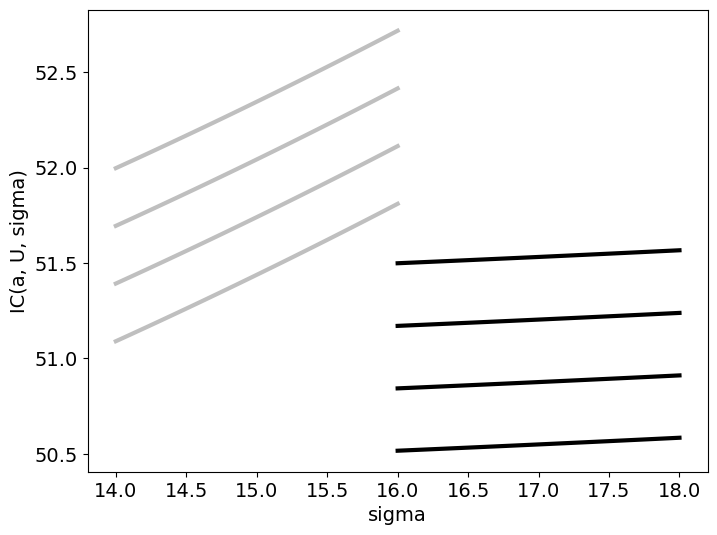

In [212]:
def IC(a, U, sigma): 
    if a==0:
        return U*sigma/sigma
    else:
        return (60*U*a**2-np.log(1-a*U) + a**2*sigma**2/1000)/a


# Define the range of sigma values
sigma = np.linspace(16,18, 100)  # Adjust the range as needed
sigma2 = np.linspace(14,16, 100)  # Adjust the range as needed

# Set the fixed value of 'a'
a = 1 # You can change this to any value you prefer
a2= 12
# Define a range of 'U' values to plot
U_values = [ .81, .815, .82, .825]

# Create a 2D plot for each 'U' value
plt.figure(figsize=(8, 6))
for U in U_values:
    IC_values = IC(a, U, sigma)
    IC_values2 = IC(a2, U/a2, sigma2)
    plt.plot(sigma, IC_values, label=f'U = {U}', color='black')
    plt.plot(sigma2, IC_values2, label=f'U = {U}', color='grey', alpha=.5)
plt.xlabel('sigma')
plt.ylabel('IC(a, U, sigma)')
#plt.ylim(40, 50)
#plt.xlim(12, 24)
#plt.legend()
#plt.grid(True)
plt.show()


### Contour Plot for number of asset

In [97]:
df = pd.read_excel("NaturalClimateSolution Portfolio.xlsx", header=4)
df = df.iloc[:20, 5:]
df = df.set_index('Pathway (Griscom 2017)')
df.head()

,Rate of avoidable impact,Max extentExtent uncertainty,Extent uncertainty 95% CI,Avoidable flux,Additional sequestration,Intensity,Intensity Low,Intensity High,Intensity Var,Flux Uncertainty 95% CI,...,Average HW,Min HW,s/sqrt(n),Var,s/sqrt(n) MIN,Var MIN,Color,Time horizon,Cover type,Intervention type
Pathway (Griscom 2017),,,,,,,,,,,,,,,,,,,,,
Avoided Forest Conversion,8.97,NaN,7.95 - 9.98,109.58,NaN,402.1586,352.320,451.410,638.980379,96 - 123,...,605.0,604.0,308.673469,9.527931e+04,308.163265,9.496460e+04,forestgreen,>100,forest,protect
Reforestation,NaN,678,230 - 1125,NaN,4.14,455.814,309.381,601.146,5539.802115,2.81 . 5.46,...,7570.0,7397.0,3862.244898,1.491694e+07,3773.979592,1.424292e+07,forestgreen,>25,forest,restore
Natural Forest Management,NaN,1914,1247 - 2350,NaN,0.21,23.121,19.818,132.120,820.734798,0.18 - 1.20,...,3651.5,549.0,1863.010204,3.470807e+06,280.102041,7.845715e+04,forestgreen,>50,forest,manage
Improved Plantation,NaN,257,199 - 335,NaN,0.47,51.747,22.020,110.100,504.873386,0.20 - 1.00,...,420.5,275.0,214.540816,4.602776e+04,140.306122,1.968581e+04,forestgreen,65,forest,manage
Fire Management,1.00,NaN,NaN,23.66,NaN,1,NaN,NaN,NaN,NaN,...,122.5,46.0,62.500000,3.906250e+03,23.469388,5.508122e+02,forestgreen,>100,forest,manage


Need to change the non repeat asset option - now you do not want repeated assets

In [100]:
# Define the number of assets to include in each portfolio
n_assets_values = [1, 2, 3, 4, 5, 6, 10, 12, 15,16, 18, 20]  # , 12, 15,16, 18, 20Modify this list with different values of n_assets

# Initialize an empty list to store results for each value of n_assets
all_results = []

# Loop through different values of n_assets
for n_assets in n_assets_values:
    #is using intensity rule out the column that has Nan for "Intensity Var"
    #df = df[df['Intensity Var'].notna()]
    asset_list = df.index
    #means = df[['Intensity']] # MgCO2e/ha/yr
    #var = df[['Intensity Var']] # MgCO2e/ha/yr
    means = df[['Mitigation Potential']] # or 'Mitigation Potential' TgCO2e/yr
    var = df[['Var']] # or VAR , VAR min has some value equal to 0, not good

    #-- How many portfolios to generate
    n_portfolios = 1000

    #-- Initialize empty list to store mean-variance pairs for plotting
    mean_variance_pairs = []
    weights_list=[]
    np.random.seed(75)

    #-- Loop through different values of p (exponentially spaced)
    p_values = np.linspace(0., 1., 5)
    #p_values = np.linspace(0., 1., 5) #this is for the 2 asset option

    cumulative_weights_list = []
    cumulative_weights_list2 = []

    for p in p_values:
        cov_data = np.zeros((len(df.index), len(df.index)))
        for i,asset1 in enumerate(asset_list):
            for j,asset2 in enumerate(asset_list):
                if asset1 == asset2:
                    cov_data[i, j] = var.loc[asset1].values[0]
                else:
                    cov_data[i, j] = p * np.sqrt(var.loc[asset1].values[0]) * np.sqrt(var.loc[asset2].values[0])
        cov = pd.DataFrame(cov_data, columns=asset_list, index=asset_list)

        #-- Loop through and generate lots of random portfolios
        for i in range(n_portfolios):
            #- Choose assets randomly without replacement
            assets = np.random.choice(asset_list, n_assets, replace=False)
            #- Choose weights randomly
            weights = np.random.rand(n_assets)
            #- Ensure weights sum to 1
            weights = weights/sum(weights)

            portfolio_E_Variance = 0
            portfolio_E_Return = 0
            for i, asset in enumerate(assets):
                portfolio_E_Return += weights[i] * means.loc[asset, 'Mitigation Potential']
                for j, asset_ in enumerate(assets):
                    #-- Add variance/covariance for each asset pair
                    #- Note that when i==j this adds the variance
                    portfolio_E_Variance += weights[i] * weights[j] * cov.loc[asset, asset_]

            # Calculate cumulative weights by cover type for the current portfolio
            cumulative_weights_by_cover_type = {}
            cover_types = df.loc[assets, "Color"]
            for asset, weight, cover_type in zip(assets, weights, cover_types):
                if cover_type not in cumulative_weights_by_cover_type:
                    cumulative_weights_by_cover_type[cover_type] = 0
                cumulative_weights_by_cover_type[cover_type] += weight
            # Append the cumulative weights to the list for all portfolios
            cumulative_weights_list.append(cumulative_weights_by_cover_type)

            # Calculate cumulative weights by intervention type for the current portfolio
            cumulative_weights_by_intervention_type = {}
            intervention_types = df.loc[assets, "Intervention type"]
            for asset, weight, intervention_type in zip(assets, weights, intervention_types):
                if intervention_type not in cumulative_weights_by_intervention_type:
                    cumulative_weights_by_intervention_type[intervention_type] = 0
                cumulative_weights_by_intervention_type[intervention_type] += weight
            cumulative_weights_list2.append(cumulative_weights_by_intervention_type)
            # Find the "Intervention type" with the maximum cumulative weight for the current portfolio
            max_intervention_type = max(cumulative_weights_by_intervention_type, key=cumulative_weights_by_intervention_type.get)

            # Find the "Cover type" with the maximum cumulative weight for the current portfolio
            max_cover_type = max(cumulative_weights_by_cover_type, key=cumulative_weights_by_cover_type.get)
            #print(assets, weights, max_cover_type)
            #-- Add the mean/variance pairs to a list for plotting
            mean_variance_pairs.append([portfolio_E_Return, portfolio_E_Variance, p])
            weights_list.append([weights,assets, max_cover_type, max_intervention_type])
    #-- Convert the list to a DataFrame for further analysis or plotting
    mean_variance_df = pd.DataFrame(mean_variance_pairs, columns=['Return', 'Variance', 'p'])
    weights_list_df = pd.DataFrame( weights_list, columns=['Weights', 'Assets', 'Max Cover', 'Max Intervention'])
    risk_free_rate=0 #-- Include risk free rate here
    weights_list_df['Sharpe Ratio'] = (mean_variance_df['Return'] - risk_free_rate) / mean_variance_df['Variance']
    # Concatenate the DataFrames horizontally
    combined_df = pd.concat([mean_variance_df, weights_list_df], axis=1)
    cumulative_weights_df = pd.DataFrame(cumulative_weights_list)
    cumulative_weights_df2=pd.DataFrame(cumulative_weights_list2)
    cumulative_weights_df = pd.concat([cumulative_weights_df,cumulative_weights_df2], axis=1)
    # Store the relevant results for this value of n_assets
    result = {
        'n_assets': n_assets,
        'combined_df': combined_df,  # Replace with the actual combined_df for this case
        # Include other relevant results you want to save
    }
    all_results.append(result)

# You can access the results for each value of n_assets using all_results
for result in all_results:
    n_assets = result['n_assets']
    combined_df = result['combined_df']

    

In [101]:
# Get the "Return," "Weights," and "Assets" corresponding to the minimum Variance value
min_var_row = combined_df.loc[combined_df['Variance'].idxmin()]
min_var_return = min_var_row['Return']
min_var_weights = min_var_row['Weights']
min_var_assets = min_var_row['Assets']

# Print the results
print(f"Minimum Variance: {min_var_row['Variance']}")
print(f"Return: {min_var_return}")
print(f"Weights: {min_var_weights}")
print(f"Assets: {min_var_assets}")

Minimum Variance: 2682.749936076043
Return: 668.1308241399946
Weights: [0.03987668 0.08880985 0.05029222 0.06688401 0.01766982 0.00566865
 0.04861743 0.08745289 0.07978062 0.00428235 0.06815844 0.03897503
 0.05032115 0.05742733 0.00276126 0.07046847 0.03581055 0.07382885
 0.0795167  0.03339769]
Assets: ['Biochar' 'Grazing - Improved feed' 'Coastal Wetland Restoration'
 'Conservation Agriculture' 'Grazing - Animal Management'
 'Natural Forest Management' 'Peatland Restoration'
 'Avoided Woodfuel Harvest' 'Improved Plantation' 'Reforestation'
 'Avoided Peatland Impacts' 'Improved Rice Cultivation'
 'Avoided Forest Conversion' 'Avoided Grassland Conversion'
 'Trees in Cropland' 'Avoided Coastal Wetland Impacts'
 'Cropland Nutrient Management' 'Fire Management'
 'Grazing - Optimal Intensity' 'Grazing - Legumes in Pastures']


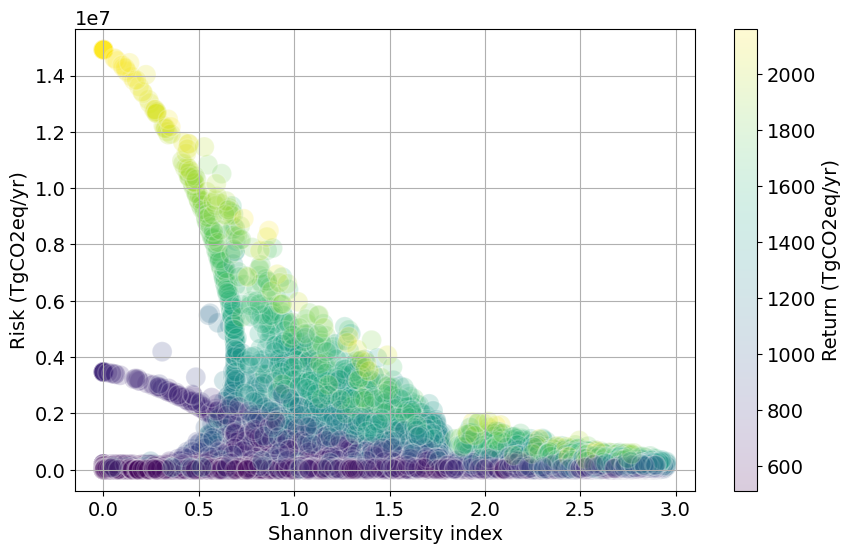

In [102]:
plt.figure(figsize=(10, 6))

# Loop through the results for different values of n_assets
for result in all_results:
    n_assets = result['n_assets']
    combined_df = result['combined_df']
    # Apply the function to each row in the DataFrame
    combined_df['shannon_index'] = combined_df['Weights'].apply(calculate_shannon_index)

    # Extract the 'p' and 'Return' values for plotting
    p_values = combined_df['p']
    returns = combined_df['Return']
    variances = combined_df['Variance']
    diversity= combined_df['shannon_index']
    # Create a scatter plot for each set of data
    #plt.scatter(max_w/n_assets, p_values, c=variances, cmap='viridis', marker='o', s=205, edgecolors='white', alpha=0.2)
    #plt.scatter(variances, returns, c=max_w/n_assets*100, cmap='viridis', marker='o', s=205, edgecolors='white', alpha=0.2)
    plt.scatter(diversity, variances, c=returns, cmap='viridis', marker='o', s=205, edgecolors='white', alpha=0.2)
    
# Customize the plot with labels, colorbar, etc.
plt.xlabel('Shannon diversity index')
plt.ylabel('Risk (TgCO2eq/yr)')
#plt.title('Scatter Plot of Return vs. p Values for Different Numbers of Assets')
plt.colorbar(label='Return (TgCO2eq/yr)')

plt.grid(True)
#plt.savefig(PATH_SAVE_FIGURES + "FigDiverse.png") 

# Show the plot
plt.show()

### Shannon diversity index

In [103]:
def calculate_shannon_index(weights):
    if isinstance(weights, np.ndarray):  # Check if it's an array
        return -np.sum(weights * np.log(weights))

In [105]:
# Create a list to store traces
traces = []

# Loop through the results for different values of n_assets
for result in all_results:
    n_assets = result['n_assets']
    combined_df = result['combined_df']
    
    # Apply the function to each row in the DataFrame
    combined_df['shannon_index'] = combined_df['Weights'].apply(calculate_shannon_index)
    
    # Extract the 'p' and 'Return' values for plotting
    p_values = combined_df['p']
    returns = combined_df['Return']
    variances = combined_df['Variance']
    diversity = combined_df['shannon_index']/np.log(n_assets)

    # Create a scatter trace for each set of data
    trace = go.Scatter(
        x=diversity,
        y=variances,
        mode='markers',
        marker=dict(
            size=15,
            color=returns,
            colorscale='RdBu_r',
            cmin=-.10,
            cmax=10000,
            showscale=True,
            opacity=0.8,
            colorbar=dict(title='Return (TgCO2eq/yr)'),
            line=dict(width=2, color='Black')
        ),
        text=returns,  # Display return values as hover text
        name=f'n_assets={n_assets}'
    )
    traces.append(trace)

# Create the figure
fig = go.Figure(data=traces)

# Customize the plot with labels, colorbar, etc.
fig.update_layout(
    xaxis_title='Shannon diversity index / ln(n° assets)',
    yaxis_title='Risk (TgCO2eq/yr)',
    coloraxis=dict(
        colorbar_title='Return (TgCO2eq/yr)',
        showscale=True  # Ensure the colorbar is displayed
    ),
    showlegend=False,
    plot_bgcolor='white',  # Set the background color of the entire figure to white
    width=800,
    height=550,

)

fig.write_image(PATH_SAVE_FIGURES + "FigShannon.pdf") 

# Show the plot
fig.show()